In [4]:
import numpy as np
import torch
import torch.nn as nn
import matplotlib.pyplot as plt
import torch.optim as optim
import itertools
import laplace
from laplace import Laplace
import torch
from torch.utils.data import TensorDataset, DataLoader, Dataset
import csv
from pathlib import Path
from scipy.stats import pearsonr
import numpy as np
import seaborn as sns

import torch.nn as nn
import matplotlib.pyplot as plt

import uncertainties.uncertainties as unc
import dataloaders as dl
import models as m

import inspect

/home/johnny/.virtualenvs/jup/lib/python3.8/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.23.4
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


In [12]:
def entropy(x, eps=0.00000000000000000001):
    return -x*np.log2(x+eps) - (1-x)*np.log2(1-x+ eps)

def generate_mlp(input_size: int, cfg= None, initial_dropout=0.5, output_layer="softmax"):
    if cfg is None:
        cfg = [256, 512, 256, 2]
    layers = [
    #    nn.Flatten(),
        nn.Linear(input_size, cfg[0]),
        nn.ReLU(),
        nn.Dropout(initial_dropout)
    ]
    if len(cfg) > 1:
        for w1, w2 in zip(cfg[:-2], cfg[1:-1]):
            layers += [nn.Linear(w1, w2), nn.ReLU(),nn.Dropout(initial_dropout)]
    layers += [nn.Linear(cfg[-2], cfg[-1])]
    model = nn.Sequential(*layers)
    model.d = sum(cfg[i] * cfg[i + 1] for i in range(len(cfg) - 1))
    return model

def insquare(x):
    return not (x[0]+1>x[1] and -x[0]-1<x[1] and -x[0]+1>x[1] and x[0]-1<x[1])

def sample_square(num, inbalanced=False, ro=0, unbalanced_p=5):
    x = np.random.uniform(-1,1,(num,2))
    if inbalanced:
        x = np.array([xx for xx in x if xx[0]>0 or xx[1]>0 or np.random.randint(unbalanced_p) == 1 or not insquare(xx)])
    y = (np.array(list(map(insquare, x))) + np.random.choice([0,1], size=x.shape[0], replace=True, p=[ro, 1-ro]))%2
    return x, 1*y

def sample_outside_square(num):
    num=int(num*2.5)
    x = np.random.uniform(-1,1,(num,2))
    y = np.array(list(map(insquare, x)))
    return x[y], [1]*len(x[y])

def sample_inside_square(num):
    num=int(num*2.5)
    x = np.random.uniform(-1,1,(num,2))
    y = np.logical_not(np.array(list(map(insquare, x))))
    return x[y], [0]*len(x[y])

def plot_experiments(alphas, c, dataset):
    fig, axs = plt.subplots(2,2, figsize=(10,10))
    for i in range(4):
        axs[i//2, i%2].scatter(
            dataset[0][:, 0],
            dataset[0][:, 1],
            alpha =alphas[i],
            c=c)

def ds(dataset, batch_size=20):
    return DataLoader(
        TensorDataset(
            torch.Tensor(dataset[0]),
            torch.LongTensor(dataset[1])
        ),
        batch_size=batch_size)

NN_COLOR = '#e63946'
BNN_COLOR =  '#1d3557'
BNN_COLOR2 =  '#305890'

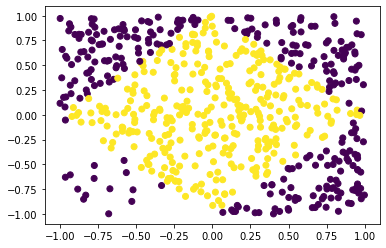

In [14]:
plt.scatter(train_square_unbalanced[0][:,0],train_square_unbalanced[0][:,1], c=train_square_unbalanced[1])

In [15]:
def normalize(x):
    return (x - np.min(x))/(np.max(x)- np.min(x))

In [16]:
from pathlib import Path

def experiment(train_dataset, test_dataset, results, axs, idx, num, architecture):
    m_normal = generate_mlp(2, architecture, initial_dropout=0)
    m_mcmc = generate_mlp(2, architecture, initial_dropout=0)
    train_dl = ds(train_dataset)
    test_dl = ds(test_dataset)
    
    c1 = m.Classifier(train_dl, test_dl, m_normal)
    c1.train_and_eval(alpha=0)
    
    preds = c1.pred(test_dl)[0]
    preds_int = (preds>0.5).astype(int)
    entropy_normal = entropy(preds)
    acc = np.mean(preds_int  == test_dataset[1])

    hmc_preds = unc.get_HMC_preds(
            train_data = train_dataset,
            net = m_mcmc,
            test_data = test_dataset,
            device = 'cpu',
            num_samples = 15000,
            L=3,
            tau=0.1)

    preds_mcmc = np.mean(hmc_preds, axis=0)
    preds_mcmc_int = ((preds_mcmc>0.5).astype(int) + 1)%2
    acc_mcmc = np.mean(preds_mcmc_int == test_dataset[1])
    entropy_mcmc = entropy(preds_mcmc)
    if idx<6:
        axs[0, idx].scatter(train_dataset[0][:, 0], train_dataset[0][:, 1], 
                           c = train_dataset[1], cmap="PiYG")
        axs[1, idx].scatter(test_dataset[0][:, 0],
                        test_dataset[0][:, 1],
                        alpha = entropy_normal,
                        c = preds_int,
                        cmap="PiYG")

        axs[2, idx].scatter(test_dataset[0][:, 0],
                        test_dataset[0][:, 1],
                        alpha = entropy_mcmc,
                        c = preds_mcmc_int,
                        cmap="PiYG")
        axs[1, idx].set_title(f"{train_dataset[0].shape[0]} NN acc = {acc}")
        axs[2, idx].set_title(f"{train_dataset[0].shape[0]} BNN acc = {acc_mcmc}")
    results.extend([[num, acc, acc_mcmc]])

In [17]:
test_square = sample_square(10000)

In [18]:
def exp(path, nums=[50, 75, 100, 200, 300, 500], unbalanced=False, architecture=[64, 32, 8, 2], ro=0.1, unbalanced_p=5):
    fig, axs = plt.subplots(3,6, figsize=(120, 60))
    results_equal = []
    if isinstance(ro, int):
        train_square = [sample_square(1000, unbalanced, ro, unbalanced_p)]*len(nums)
    else:
        train_square = [sample_square(1000, unbalanced, r, unbalanced_p) for r in ro]
    
    for idx, i in enumerate(nums):
        data = [x[:i] for x in train_square[idx]]
        experiment(data, test_square, results_equal, axs, idx, i, architecture)
    
    path = "results_toy_example/" + path
    Path(path).mkdir(parents=True, exist_ok=True)
    
    with open(f'{path}/acc_results.csv', 'w') as file:
        writer = csv.writer(file)
        writer.writerow(["num", "Standard", "MCMC "])
        [writer.writerow(r) for r in results_equal]
    with open(f'{path}/readme.txt', 'w') as f:
        f.write(str(results_equal))
    plt.savefig(f"{path}/plots.png")
    plt.show()
    plt.scatter(nums, [r[1] for r in results_equal], color=NN_COLOR)
    plt.scatter(nums, [r[2] for r in results_equal], color=BNN_COLOR)
    plt.show()
    sns.kdeplot(np.array([r[1] for r in results_equal]), bw=0.5)
    sns.kdeplot(np.array([r[2] for r in results_equal]), bw=0.5)
    plt.show()

Classifier training has finished with acc: 0.950
Test acc: 0.721
Sampling (Sampler.HMC; Integrator.IMPLICIT)
Time spent  | Time remain.| Progress             | Samples     | Samples/sec
Final Adapted Step Size:  0.05006136745214462--- |   100/15000 | 199.76       
0d:00:01:18 | 0d:00:00:00 | #################### | 15000/15000 | 191.83       
Acceptance Rate 0.49
Classifier training has finished with acc: 0.943
Test acc: 0.854
Sampling (Sampler.HMC; Integrator.IMPLICIT)
Time spent  | Time remain.| Progress             | Samples     | Samples/sec
Final Adapted Step Size:  0.025909291580319405-- |    97/15000 | 193.89       
0d:00:01:20 | 0d:00:00:00 | #################### | 15000/15000 | 185.84       
Acceptance Rate 0.20
Classifier training has finished with acc: 0.975
Test acc: 0.887
Sampling (Sampler.HMC; Integrator.IMPLICIT)
Time spent  | Time remain.| Progress             | Samples     | Samples/sec
Final Adapted Step Size:  0.023979660123586655-- |    97/15000 | 193.21       
0d:00

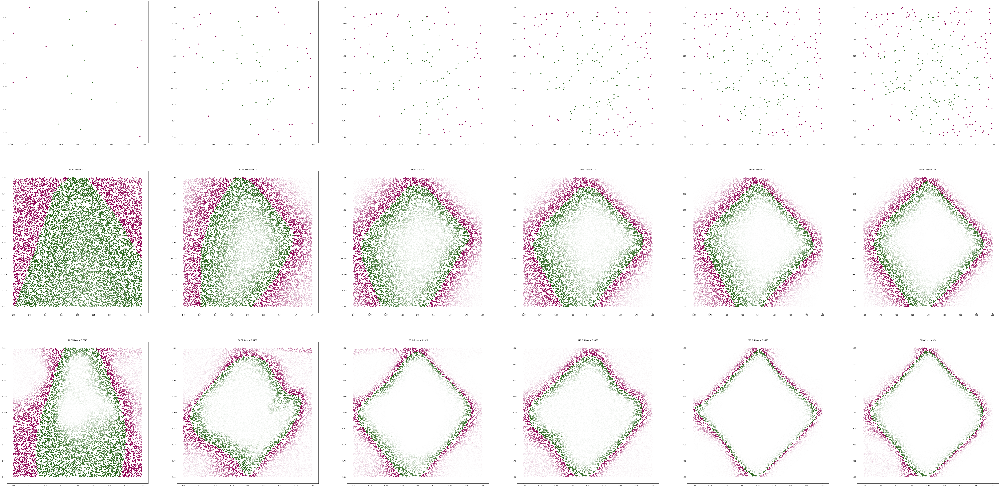

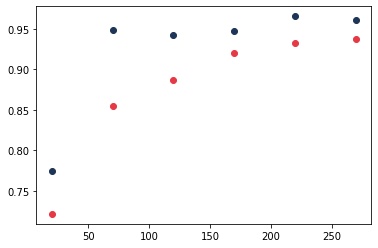

/home/johnny/.virtualenvs/jup/lib/python3.8/site-packages/seaborn/distributions.py:1699: FutureWarning: The `bw` parameter is deprecated in favor of `bw_method` and `bw_adjust`. Using 0.5 for `bw_method`, but please see the docs for the new parameters and update your code.
  warnings.warn(msg, FutureWarning)
/home/johnny/.virtualenvs/jup/lib/python3.8/site-packages/seaborn/distributions.py:1699: FutureWarning: The `bw` parameter is deprecated in favor of `bw_method` and `bw_adjust`. Using 0.5 for `bw_method`, but please see the docs for the new parameters and update your code.
  warnings.warn(msg, FutureWarning)


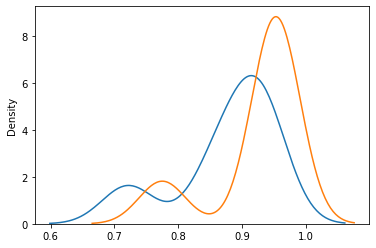

In [26]:
exp("biblio_16_8_2_5", nums=np.arange(20, 280, 50), unbalanced=True, unbalanced_p=5, architecture=[16,8,2], ro=0)

Classifier training has finished with acc: 1.000
Test acc: 0.736
Sampling (Sampler.HMC; Integrator.IMPLICIT)
Time spent  | Time remain.| Progress             | Samples     | Samples/sec
Final Adapted Step Size:  0.0630047619342804---- |    86/15000 | 171.74       
0d:00:01:30 | 0d:00:00:00 | #################### | 15000/15000 | 165.39       
Acceptance Rate 0.21
Classifier training has finished with acc: 0.929
Test acc: 0.863
Sampling (Sampler.HMC; Integrator.IMPLICIT)
Time spent  | Time remain.| Progress             | Samples     | Samples/sec
Final Adapted Step Size:  0.02164955623447895--- |    84/15000 | 167.48       
0d:00:01:34 | 0d:00:00:00 | #################### | 15000/15000 | 158.35       
Acceptance Rate 0.13
Classifier training has finished with acc: 0.958
Test acc: 0.838
Sampling (Sampler.HMC; Integrator.IMPLICIT)
Time spent  | Time remain.| Progress             | Samples     | Samples/sec
Final Adapted Step Size:  0.017992636188864708-- |    80/15000 | 160.61       
0d:00

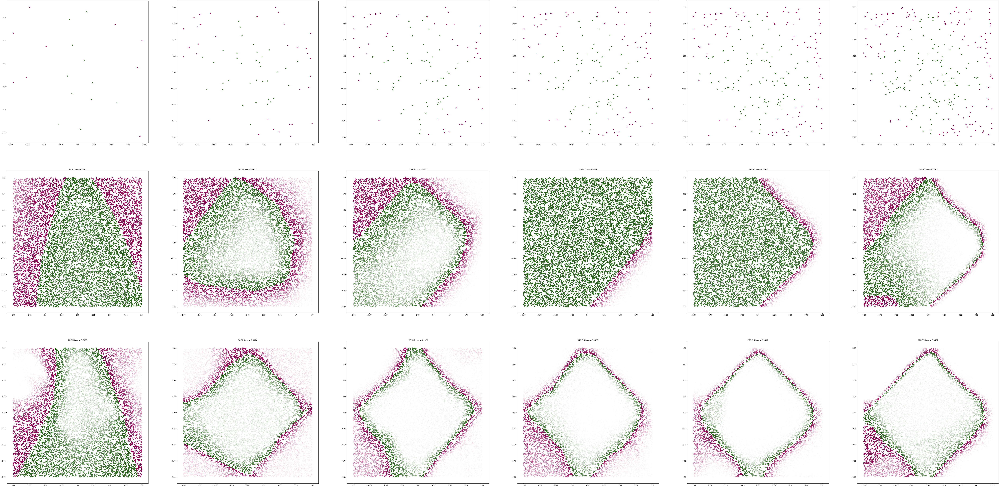

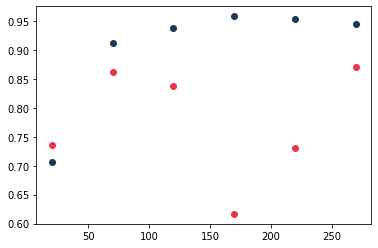

/home/johnny/.virtualenvs/jup/lib/python3.8/site-packages/seaborn/distributions.py:1699: FutureWarning: The `bw` parameter is deprecated in favor of `bw_method` and `bw_adjust`. Using 0.5 for `bw_method`, but please see the docs for the new parameters and update your code.
  warnings.warn(msg, FutureWarning)
/home/johnny/.virtualenvs/jup/lib/python3.8/site-packages/seaborn/distributions.py:1699: FutureWarning: The `bw` parameter is deprecated in favor of `bw_method` and `bw_adjust`. Using 0.5 for `bw_method`, but please see the docs for the new parameters and update your code.
  warnings.warn(msg, FutureWarning)


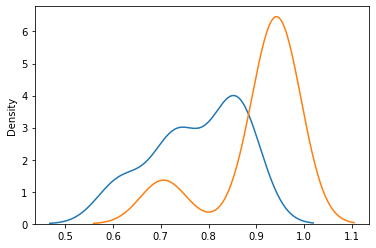

In [27]:
exp("biblio_16_8_4_2_10", nums=np.arange(20, 280, 50), unbalanced=True, unbalanced_p=10, architecture=[16,8,4,2], ro=0)

Classifier training has finished with acc: 1.000
Test acc: 0.780
Sampling (Sampler.HMC; Integrator.IMPLICIT)
Time spent  | Time remain.| Progress             | Samples     | Samples/sec
Final Adapted Step Size:  0.03103359043598175--- |    88/15000 | 174.73       
0d:00:01:33 | 0d:00:00:00 | #################### | 15000/15000 | 160.40       
Acceptance Rate 0.52
Classifier training has finished with acc: 0.986
Test acc: 0.843
Sampling (Sampler.HMC; Integrator.IMPLICIT)
Time spent  | Time remain.| Progress             | Samples     | Samples/sec
Final Adapted Step Size:  0.026436209678649902-- |    83/15000 | 165.40       
0d:00:01:35 | 0d:00:00:00 | #################### | 15000/15000 | 156.47       
Acceptance Rate 0.05
Classifier training has finished with acc: 0.992
Test acc: 0.845
Sampling (Sampler.HMC; Integrator.IMPLICIT)
Time spent  | Time remain.| Progress             | Samples     | Samples/sec
Final Adapted Step Size:  0.017630506306886673-- |    82/15000 | 165.26       
0d:00

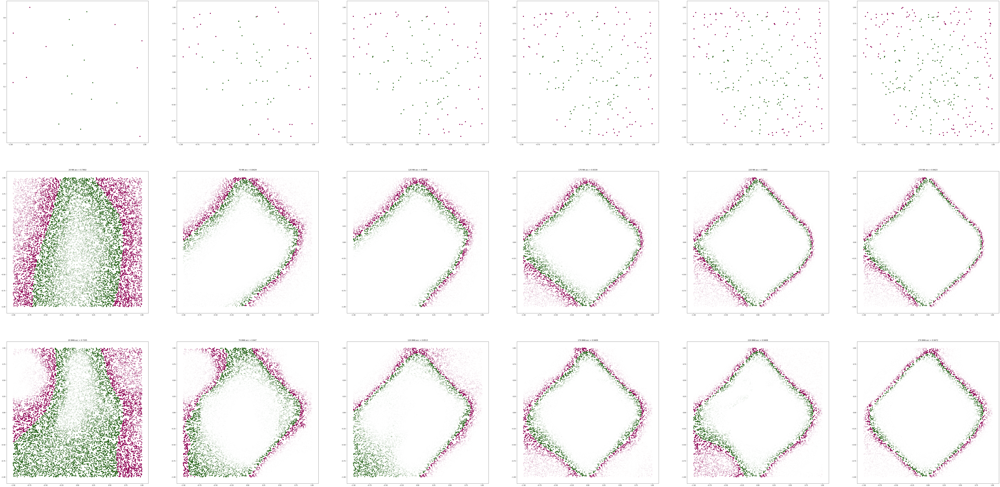

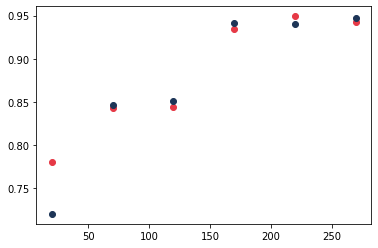

/home/johnny/.virtualenvs/jup/lib/python3.8/site-packages/seaborn/distributions.py:1699: FutureWarning: The `bw` parameter is deprecated in favor of `bw_method` and `bw_adjust`. Using 0.5 for `bw_method`, but please see the docs for the new parameters and update your code.
  warnings.warn(msg, FutureWarning)
/home/johnny/.virtualenvs/jup/lib/python3.8/site-packages/seaborn/distributions.py:1699: FutureWarning: The `bw` parameter is deprecated in favor of `bw_method` and `bw_adjust`. Using 0.5 for `bw_method`, but please see the docs for the new parameters and update your code.
  warnings.warn(msg, FutureWarning)


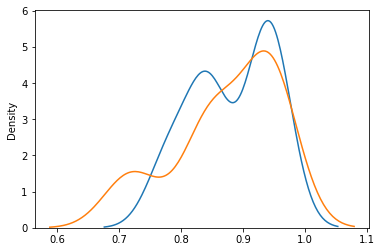

In [29]:
exp("biblio_32_16_4_2_20", nums=np.arange(20, 280, 50), unbalanced=True, unbalanced_p=20, architecture=[32,16,4,2], ro=0)